<a href="https://colab.research.google.com/github/deeptishri143/deeplearning_authorization/blob/master/restaurant.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**The notebook contains insights for the restaurant experience with visualizations. Also, a predictive model with 94% accuracy is built for the rating of the restaurant using Random Forest.**
**Few insights are- **
1. Customers prefer Chicken, Mutton, Rolls
2. Overall sentiment is very positive for the food business
3. Preferred restaurants or outlets are Lassi shop, Apsara Icecream, Hottey Smokey, McDonalds, Ramji Chaiwala. It's summer season and customers are enjoying cold foods. They are must on the menu
4. Preferred restaurant type are quickbites, casual dining
5. People prefer spending between 150-650 approximately for two persons
6. Most popular locations of customers is BTM
7. Online orders are preferred by the customers
8. Online orders are preferred by the customers
9. Most popular cuisine is North Indian
10. Table booking is not preferred for dine in
11. Online orders are trending at BTM, Whitefield, Marathahalli
12. Maximum restaurants are listed in type dine-out and delivery
13. Rating restaurantof the increases as the number of votes increases
14. Random Forest model predicts the rating of the restaurant with 94% accuracy

In [1]:
import pandas as pd
import numpy as np
import sklearn as sk
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud,STOPWORDS
from textblob import TextBlob
import re
from collections import Counter
import warnings
warnings.filterwarnings("ignore")
import os
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score


/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [3]:
from google.colab import files
files.upload()

Saving RestoInfo.csv to RestoInfo.csv


{'RestoInfo.csv': b',name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)\r\n46019,Unique Brew Cafe Resto,No,No,,0,Indiranagar,Quick Bites,,Fast Food,200,[],[],Dine-out,Old Airport Road\r\n28849,Jayanthi Sagar,No,No,3.1 /5,21,Koramangala 5th Block,Quick Bites,,"South Indian, North Indian, Chinese",200,"[(\'Rated 2.0\', ""RATEDn  Works only because it\'s cheap and near offices and colleges... food is avoidable at best though they make a good case for a filter coffee.nnSpare your wallet and move on after a coffee.""), (\'Rated 3.0\', \'RATEDn  Nice and cheap place with good food. If you are a office goer ,you can have good south indian food. Service is fast and place is well located\'), (\'Rated 3.5\', \'RATEDn  This place is good stop if you are planning for a quick breakfast or lunch. Starting from idli to south indian thaali this place is nice for south indian foos.service at t

In [5]:
df= pd.read_csv('/content/RestoInfo.csv')

In [6]:
df.head()

,Unnamed: 0,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,46019,Unique Brew Cafe Resto,No,No,NaN,0,Indiranagar,Quick Bites,NaN,Fast Food,200,[],[],Dine-out,Old Airport Road
1,28849,Jayanthi Sagar,No,No,3.1 /5,21,Koramangala 5th Block,Quick Bites,NaN,"South Indian, North Indian, Chinese",200,"[('Rated 2.0', ""RATEDn Works only because it'...",[],Dine-out,Koramangala 4th Block
2,19855,Rock Stone Ice Cream Factory,Yes,No,4.0/5,131,BTM,Dessert Parlor,"Icecream Cake, Brownie, Waffles, Chocolate Ice...",Ice Cream,230,"[('Rated 4.0', ""RATEDn Ice creams are really ...","['Midnight Indulgence Cake', 'Butterscotch Mel...",Delivery,Jayanagar
3,35188,Punjabi by Nature 2.0,No,No,4.2 /5,3236,BTM,"Casual Dining, Microbrewery","Paneer Tikki, Mutton Raan, Mango Margarita, Cr...",North Indian,NaN,"[('Rated 3.0', ""RATEDn It has a beautiful amb...",[],Delivery,Koramangala 7th Block
4,7070,Rayalaseema Chefs,Yes,Yes,3.9/5,225,Marathahalli,Casual Dining,"Bamboo Chicken, Butter Naan, Mutton Biryani, P...","North Indian, Biryani, Andhra, Chinese",800,"[('Rated 5.0', 'RATEDn Had Good experience wi...",[],Delivery,Brookefield


In [7]:
df.drop(['Unnamed: 0', 'menu_item'], axis= 1, inplace= True)

In [8]:
df.shape

(2069, 13)

In [9]:
df.isna().sum()

name                              0
online_order                      0
book_table                        0
rate                            299
votes                             0
location                          0
rest_type                        17
dish_liked                     1107
cuisines                          0
approx_cost(for two people)      16
reviews_list                      0
listed_in(type)                   0
listed_in(city)                   0
dtype: int64

## **Data Preprocessing**

**Extract rating from reviews**

In [10]:
df['current_rating']= df.reviews_list.str.extract('(\d+)')

**Removing stopwords**

In [11]:
for i in range(df.shape[0]) :
    df['reviews_list'][i] = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)|(#[A-Za-z0-9]+)", " ", df['reviews_list'][i]).split()).lower()
custon_stop_words= ['rate', 'rated', 'ratedn','0',]
[STOPWORDS.add(n) for n in custon_stop_words]        
stopwords = set(STOPWORDS)
df['reviews_list'] = df['reviews_list'].apply(lambda dfs: ' '.join([word for word in dfs.split() if word not in stopwords]))
df.head()

,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,listed_in(type),listed_in(city),current_rating
0,Unique Brew Cafe Resto,No,No,NaN,0,Indiranagar,Quick Bites,NaN,Fast Food,200,,Dine-out,Old Airport Road,NaN
1,Jayanthi Sagar,No,No,3.1 /5,21,Koramangala 5th Block,Quick Bites,NaN,"South Indian, North Indian, Chinese",200,2 works s cheap near offices colleges food avo...,Dine-out,Koramangala 4th Block,2
2,Rock Stone Ice Cream Factory,Yes,No,4.0/5,131,BTM,Dessert Parlor,"Icecream Cake, Brownie, Waffles, Chocolate Ice...",Ice Cream,230,4 ice creams really tasty especially belgian c...,Delivery,Jayanagar,4
3,Punjabi by Nature 2.0,No,No,4.2 /5,3236,BTM,"Casual Dining, Microbrewery","Paneer Tikki, Mutton Raan, Mango Margarita, Cr...",North Indian,NaN,3 beautiful ambiance managed table right next ...,Delivery,Koramangala 7th Block,3
4,Rayalaseema Chefs,Yes,Yes,3.9/5,225,Marathahalli,Casual Dining,"Bamboo Chicken, Butter Naan, Mutton Biryani, P...","North Indian, Biryani, Andhra, Chinese",800,5 good experience restaurant ragi mudda good w...,Delivery,Brookefield,5


**Analyzing text using TextBlob to predict the sentiment of the text and categorise it as 'Positive', 'Negative'**

In [12]:
df['sentiment'] = ' '
df['polarity'] = None
for i,reviews in enumerate(df['reviews_list']) :
    blob = TextBlob(reviews)
    df['polarity'][i] = blob.sentiment.polarity
    if (blob.sentiment.polarity > 0) or (blob.sentiment.polarity == 0) :
        df['sentiment'][i] = 'positive'
    elif blob.sentiment.polarity < 0 :
        df['sentiment'][i] = 'negative'

In [13]:
df['reviews_list'] = df['reviews_list'].apply(lambda dfs: ' '.join([word for word in dfs.split() if word not in stopwords]))

**WORD CLOUD**

In [14]:
def show_wordcloud(data , title = None):
    wordcloud = WordCloud(background_color='black',stopwords=stopwords,max_words=200,max_font_size=40).generate(str(data))
  
    fig = plt.figure(1, figsize=(15, 15))
    plt.axis('off')
    plt.title(title, size = 25)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.show()

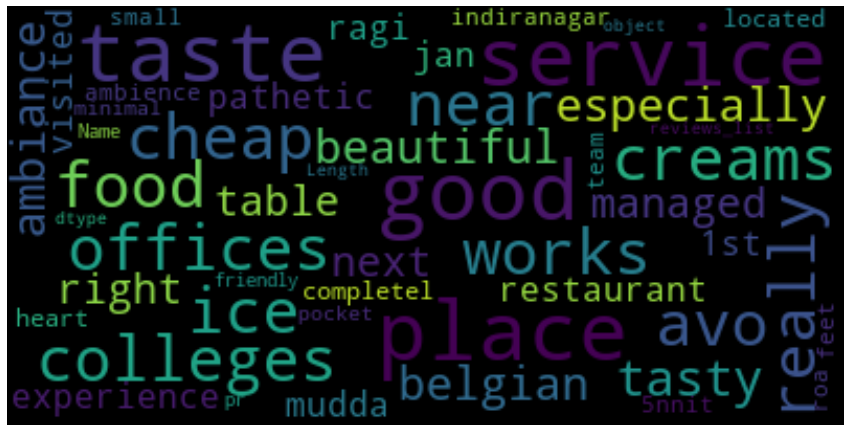

In [15]:
show_wordcloud(df['reviews_list'])

**Word cloud for positive, negative sentiments**

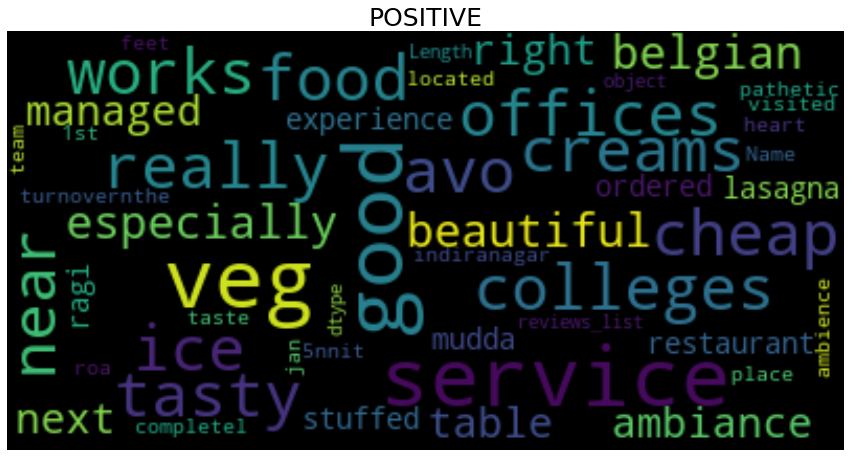

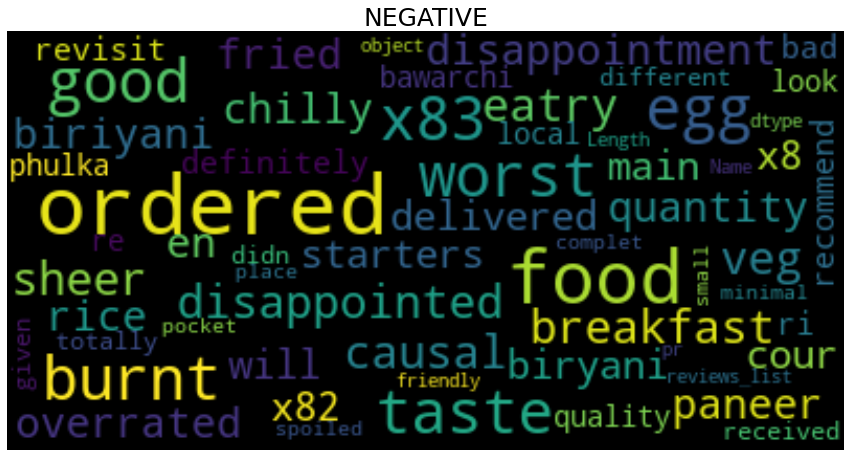

In [16]:
pos = df['reviews_list'][df['sentiment'] == 'positive']
show_wordcloud(pos , 'POSITIVE')
neg = df['reviews_list'][df['sentiment'] == 'negative']
show_wordcloud(neg , 'NEGATIVE')

**Favourite dishes: Chicken, rolls, Mutton**

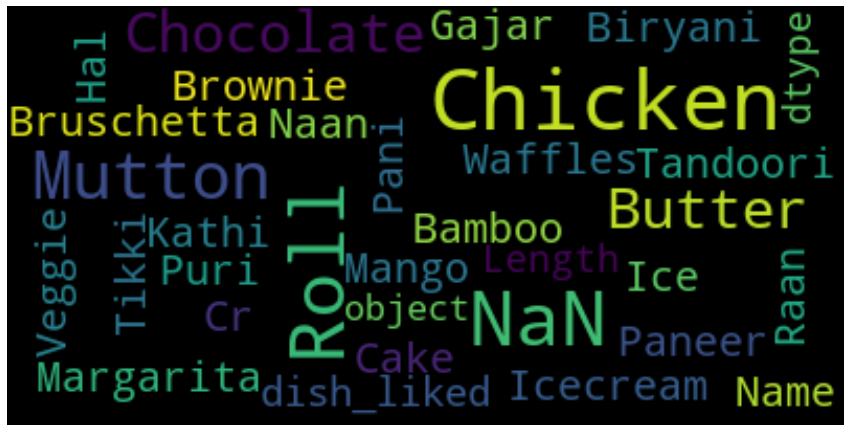

In [17]:
show_wordcloud(df['dish_liked'])

**Maximum reviews are positive and customers are enjoying the food experience**

positive    1911
negative     158
Name: sentiment, dtype: int64


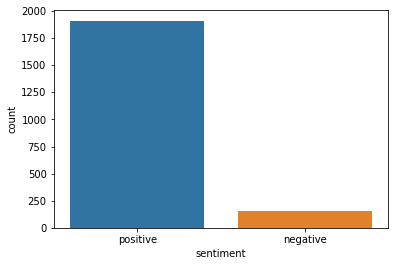

In [18]:
print(df.sentiment.value_counts())
sns.countplot(x='sentiment', data = df);

 **Preferred restaurants or outlets are Lassi shop, Apsara Icecream, Hottey Smokey, McDonalds, Ramji Chaiwala**
 
**It's summer season and customers are enjoying cold foods. They are must on the menu**

Text(0.5, 0, 'Number of outlets')

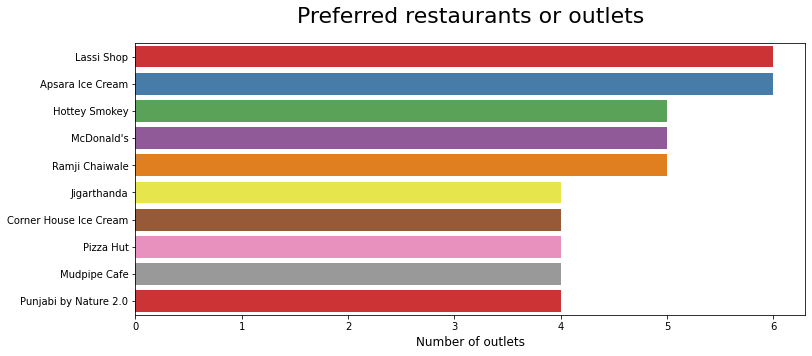

In [19]:
plt.figure(figsize=(12,5))
pic=df['name'].value_counts()[:10]
sns.barplot(x=pic,y=pic.index,palette='Set1')
plt.title("Preferred restaurants or outlets",size=22,pad=20)
plt.xlabel("Number of outlets",size=12)

**Preferred restaurant type are quickbites, casual dining**

Text(0.5, 0, 'Count')

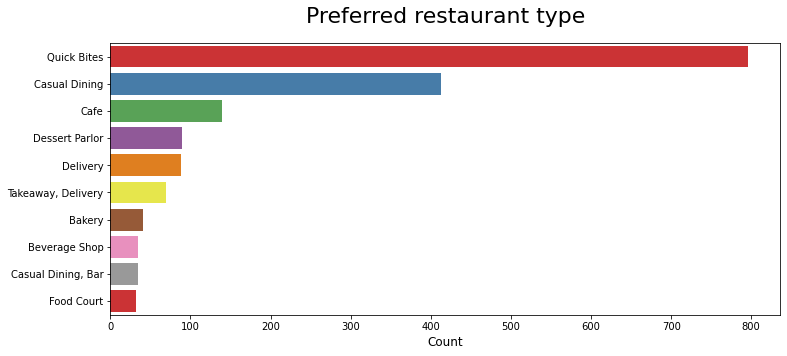

In [20]:
plt.figure(figsize=(12,5))
pic=df['rest_type'].value_counts()[:10]
sns.barplot(x=pic,y=pic.index,palette='Set1')
plt.title("Preferred restaurant type",size=22,pad=20)
plt.xlabel("Count",size=12)

In [21]:
df['approx_cost(for two people)'] = df['approx_cost(for two people)'].astype(str) 
df['approx_cost(for two people)'] = df['approx_cost(for two people)'].apply(lambda x: x.replace(',','.')) 
df['approx_cost(for two people)'] = df['approx_cost(for two people)'].astype(float)

**People prefer spending between 150-650 approximately for two persons**

Text(0.5, 1.0, 'Cost for 2 people')

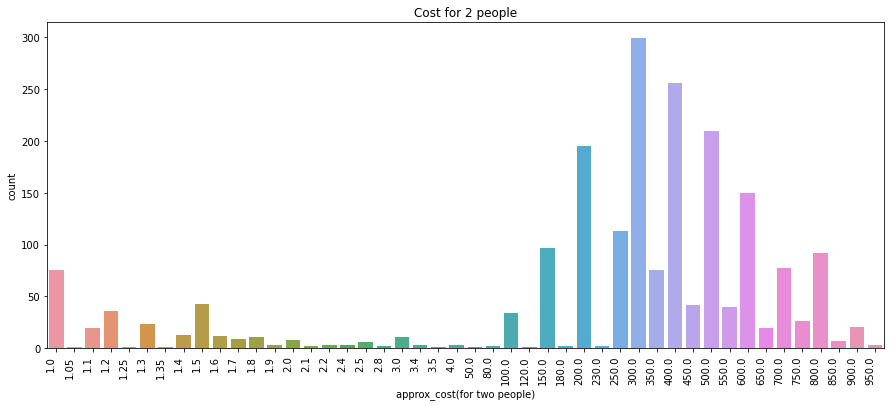

In [22]:
sns.countplot(df['approx_cost(for two people)'])
sns.countplot(df['approx_cost(for two people)']).set_xticklabels(sns.countplot(df['approx_cost(for two people)']).get_xticklabels(), rotation=90, ha="right")
fig = plt.gcf()
fig.set_size_inches(15,6)
plt.title('Cost for 2 people')

**Most popular locations of customers is BTM**

Text(0.5, 0, 'Count')

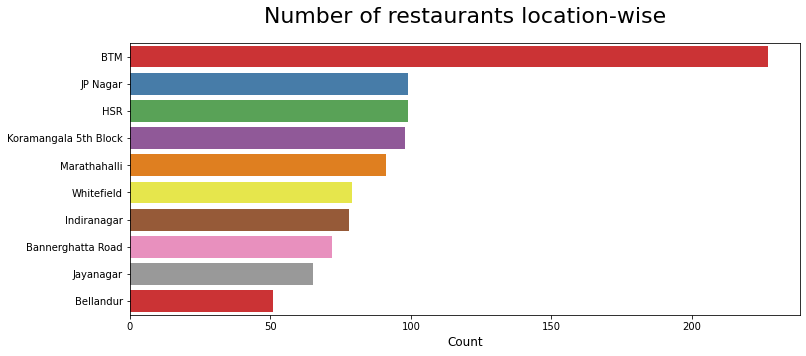

In [23]:
plt.figure(figsize=(12,5))
pic=df['location'].value_counts()[:10]
sns.barplot(x=pic,y=pic.index,palette='Set1')
plt.title("Number of restaurants location-wise",size=22,pad=20)
plt.xlabel("Count",size=12)

**Online orders are preferred by the customers**

Text(0.5, 1.0, 'Online order')

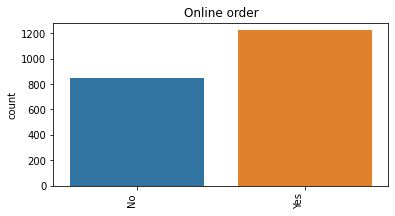

In [24]:
sns.countplot(df['online_order'])
sns.countplot(df['online_order']).set_xticklabels(sns.countplot(df['online_order']).get_xticklabels(), rotation=90, ha="right")
fig = plt.gcf()
fig.set_size_inches(6,3)
plt.xlabel("")
plt.title('Online order')

**Most popular cuisines: North Indian**

Text(0.5, 0, 'Count')

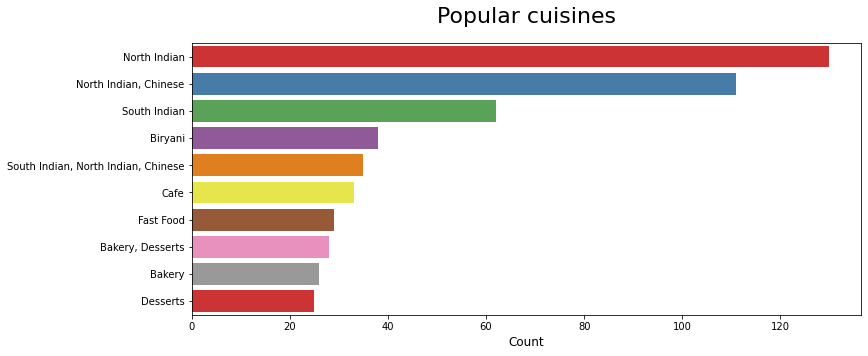

In [25]:
plt.figure(figsize=(12,5))
pic=df['cuisines'].value_counts()[:10]
sns.barplot(x=pic,y=pic.index,palette='Set1')
plt.title("Popular cuisines",size=22,pad=20)
plt.xlabel("Count",size=12)

**Table booking is not preferred for dine in**

No     739
Yes    109
Name: book_table, dtype: int64

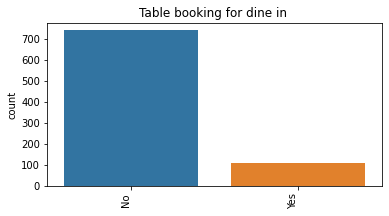

In [26]:
sns.countplot(df[df['online_order']=='No']['book_table'])
sns.countplot(df[df['online_order']=='No']['book_table']).set_xticklabels(sns.countplot(df[df['online_order']=='No']['book_table']).get_xticklabels(), rotation=90, ha="right")
fig = plt.gcf()
fig.set_size_inches(6,3)
plt.xlabel("")
plt.title('Table booking for dine in ')
df[df['online_order']=='No']['book_table'].value_counts()

**Maximum restaurants are listed in type dine-out and delivery**

Text(0.5, 1.0, 'Listed type')

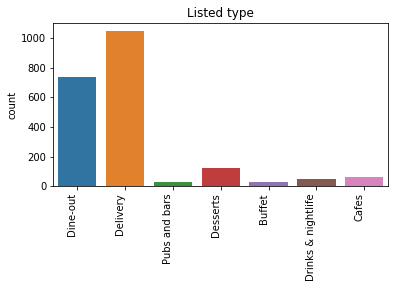

In [27]:
sns.countplot(df['listed_in(type)'])
sns.countplot(df['listed_in(type)']).set_xticklabels(sns.countplot(df['listed_in(type)']).get_xticklabels(), rotation=90, ha="right")
fig = plt.gcf()
fig.set_size_inches(6,3)
plt.xlabel("")
plt.title('Listed type')

**Locationwise online order: BTM, Whitefield, Marathahalli**

Text(0.5, 0, '')

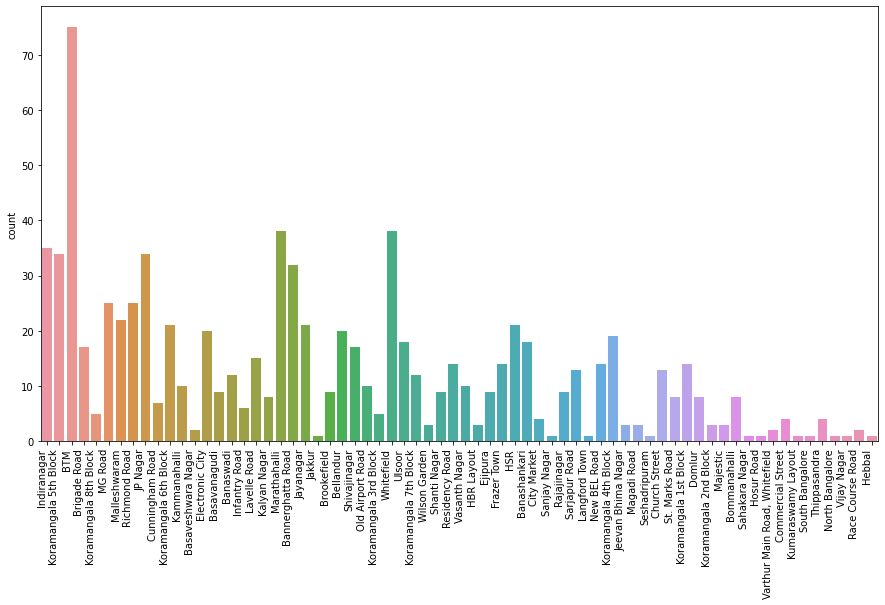

In [28]:
sns.countplot(df[df['online_order']=='No']['location'])
sns.countplot(df[df['online_order']=='No']['location']).set_xticklabels(sns.countplot(df[df['online_order']=='No']['location']).get_xticklabels(), rotation=90, ha="right")
fig = plt.gcf()
fig.set_size_inches(15,8)
plt.xlabel("")

**Extract rating and converting them to float**

In [29]:
df['rate'].unique()

array([nan, '3.1 /5', '4.0/5', '4.2 /5', '3.9/5', '4.1 /5', '3.3/5',
       '4.4/5', '3.8/5', '3.1/5', '3.5/5', '3.8 /5', '2.9/5', '4.1/5',
       '3.7/5', '3.5 /5', '3.4 /5', '3.7 /5', '4.5/5', '4.3 /5', '3.6/5',
       '2.8 /5', '3.2/5', '4.0 /5', '2.9 /5', '3.0 /5', '4.4 /5',
       '3.2 /5', '4.6 /5', 'NEW', '3.9 /5', '3.0/5', '4.8 /5', '3.6 /5',
       '3.3 /5', '4.5 /5', '2.8/5', '3.4/5', '4.2/5', '2.1/5', '4.9 /5',
       '4.3/5', '2.7/5', '2.6/5', '2.7 /5', '2.2/5', '2.4/5', '2.5 /5',
       '2.1 /5', '1.8 /5', '2.6 /5', '4.7 /5', '-', '2.3/5', '4.6/5',
       '2.2 /5'], dtype=object)

In [30]:
df1=df
df.dropna()
remove_slash = lambda x: x.replace('/5', '') if type(x) == np.str else x
df = df.loc[df['rate'] !='NEW' ]
df = df.loc[df['rate'] !='-' ]

df.rate= df.rate.str.extract('(\d+)')
df.rate = df.rate.apply(remove_slash).str.strip().astype('float')
df.votes= df.votes.astype('float')


**Rating increases as the number of votes increases**

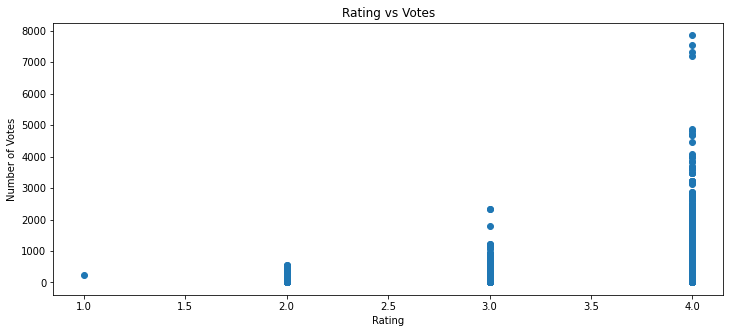

In [31]:
plt.figure(figsize=(12,5))
a = df['rate']
b = df['votes']
plt.xlabel('Rating')
plt.ylabel('Number of Votes')
plt.title('Rating vs Votes')
plt.scatter(a,b)
plt.show()

## **Predicting rating of the restaurant using random forest**

In [32]:
df.isnull().sum()
df.dropna(how='any',inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 930 entries, 2 to 2066
Data columns (total 16 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   name                         930 non-null    object 
 1   online_order                 930 non-null    object 
 2   book_table                   930 non-null    object 
 3   rate                         930 non-null    float64
 4   votes                        930 non-null    float64
 5   location                     930 non-null    object 
 6   rest_type                    930 non-null    object 
 7   dish_liked                   930 non-null    object 
 8   cuisines                     930 non-null    object 
 9   approx_cost(for two people)  930 non-null    float64
 10  reviews_list                 930 non-null    object 
 11  listed_in(type)              930 non-null    object 
 12  listed_in(city)              930 non-null    object 
 13  current_rating     

In [33]:
df = df[np.isfinite(df['rate'])] 
df= df.drop(['reviews_list', 'sentiment', 'polarity'], axis= 1)
numerical = df.select_dtypes(include=['int', 'int64', 'float'])
category = df.select_dtypes(include=['category','object','bool'])
cols= category.columns
cols

Index(['name', 'online_order', 'book_table', 'location', 'rest_type',
       'dish_liked', 'cuisines', 'listed_in(type)', 'listed_in(city)',
       'current_rating'],
      dtype='object')

In [34]:
category= pd.get_dummies(category)
category

,name_1131 Bar + Kitchen,name_1441 Pizzeria,name_1522 - The Pub,name_1947,name_1Q1,name_2 Statez,name_20 Char - Sterlings MAC Hotel,name_20 Feet High,name_3 Leafs,"name_3B's - Buddies, Bar & Barbecues",name_4 Seasons Restaurant,name_55 Wall Street,name_7 Plates,name_99 Pancakes,name_A 1 Pizza and Food,name_A2B - Adyar Ananda Bhavan,name_ASEAN - On The Edge,name_Aaha,name_Aaharam,name_Aalishan Restaurant & Caterer,name_Aasife & Brothers Biriyani Centre,name_Achayyan's,name_Agent Jack's Bar,name_Al-Bek,name_Alankrutha,name_Alba - JW Marriott Bengaluru,name_Alchemy - The Chancery Pavilion,name_Alchemy Coffee Roasters,name_Alibaba Cafe and Restaurant,name_Alibi - Maya International Hotel,name_Aligarh House,name_Altaf's Chillies Restaurant,name_Amande Patisserie,name_Amaravati Authentic Andhra Restaurant,name_Amma's Pastries,name_An Egg Story,name_Anand Sweets And Savouries,name_Anda Ka Funda,name_Ande Ka Funda,name_Andhra Ruchulu,...,listed_in(type)_Delivery,listed_in(type)_Desserts,listed_in(type)_Dine-out,listed_in(type)_Drinks & nightlife,listed_in(type)_Pubs and bars,listed_in(city)_BTM,listed_in(city)_Banashankari,listed_in(city)_Bannerghatta Road,listed_in(city)_Basavanagudi,listed_in(city)_Bellandur,listed_in(city)_Brigade Road,listed_in(city)_Brookefield,listed_in(city)_Church Street,listed_in(city)_Electronic City,listed_in(city)_Frazer Town,listed_in(city)_HSR,listed_in(city)_Indiranagar,listed_in(city)_JP Nagar,listed_in(city)_Jayanagar,listed_in(city)_Kalyan Nagar,listed_in(city)_Kammanahalli,listed_in(city)_Koramangala 4th Block,listed_in(city)_Koramangala 5th Block,listed_in(city)_Koramangala 6th Block,listed_in(city)_Koramangala 7th Block,listed_in(city)_Lavelle Road,listed_in(city)_MG Road,listed_in(city)_Malleshwaram,listed_in(city)_Marathahalli,listed_in(city)_New BEL Road,listed_in(city)_Old Airport Road,listed_in(city)_Rajajinagar,listed_in(city)_Residency Road,listed_in(city)_Sarjapur Road,listed_in(city)_Whitefield,current_rating_1,current_rating_2,current_rating_3,current_rating_4,current_rating_5
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2062,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1
2063,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2064,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2065,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [35]:
output= df.iloc[:, 3]
output

2       4.0
4       3.0
5       4.0
7       4.0
8       3.0
       ... 
2062    4.0
2063    4.0
2064    3.0
2065    4.0
2066    4.0
Name: rate, Length: 930, dtype: float64

In [36]:
cols= numerical.columns
scaler = StandardScaler() 
numerical[cols] = scaler.fit_transform(numerical[cols])

In [37]:
df = pd.concat([category, numerical], axis=1)
len(df.columns)

2199

In [38]:
X_train, X_test, y_train, y_test = train_test_split(df, output, test_size=0.2, random_state=0)

In [39]:
model = RandomForestClassifier()

In [40]:
model.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [41]:
prediction_test = model.predict(X_test)

In [42]:
print ('TEST RESULT')
print ('Accuracy RF:', accuracy_score(y_test, prediction_test))
print ('F1 score:', f1_score(y_test,prediction_test ,average='weighted'))
print ('Recall:', recall_score(y_test,prediction_test ,average='weighted'))
print ('Precision:', precision_score(y_test, prediction_test,average='weighted') )

TEST RESULT
Accuracy RF: 0.9516129032258065
F1 score: 0.9406298364847588
Recall: 0.9516129032258065
Precision: 0.9566184649610677
